# CNN for `reduced` dataset

### Things to keep in mind

- (only with colab) to maintain the runtime even after many hours of connection we can open the console (f12) and copy-paste this



```
function ClickConnect(){
    console.log("Working"); 
    document.querySelector("#comments").click() 
}
setInterval(ClickConnect,60000)
```

Attention: sometimes it asks whether you're human or not via captcha. 

- remember to add each function to the utils' scripts after its finalization
- to connect to VM GCE use the following credentials 


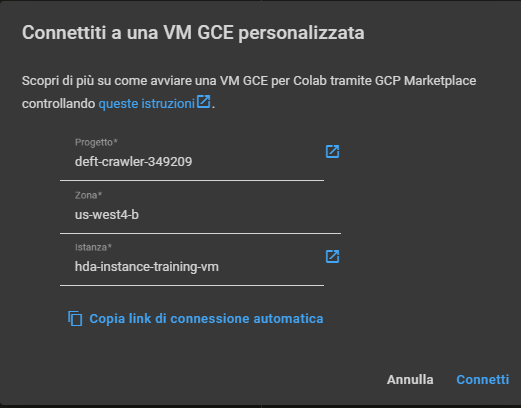

### Custom Functions

In [ ]:
def plot_history(history, model = None, save_path = None, validation = True, data_type = None):
    
    """

    Plots accuracy/loss for training/validation set as a function of the epochs.

    Parameters:
      history: Training history of model.
      model: model onject.
      filename: Name of the file.

    """
    
    fig, axs = plt.subplots(2)

    # Create accuracy subplot
    axs[0].plot(history.history["accuracy"], label="accuracy")
    if validation: 
        axs[0].plot(history.history['val_accuracy'], label="val_accuracy")
    axs[0].set_ylabel("Accuracy")
    axs[0].legend(loc="lower right")
    axs[0].set_title("Accuracy evaluation of {} - {} data".format(model._name if model else "Unspecified", data_type if model else "Unspecified"))

    # Create loss subplot
    axs[1].plot(history.history["loss"], label="loss")
    if validation:
        axs[1].plot(history.history['val_loss'], label="val_loss")
    axs[1].set_xlabel("Epoch")
    axs[1].set_ylabel("Loss")
    axs[1].legend(loc="upper right")
    axs[1].set_title("Loss evaluation {} - {} data".format(model._name if model else "Unspecified", data_type if model else "Unspecified"))

    if save_path: 
        plt.savefig(save_path)

    plt.show()
    
def plot_confusion_matrix(cm, labels, title = "Confusion Matrix", normalize = False, display_metrics = True, figsize = (7,7)):
    """
    This function makes the plot of a given a sklearn confusion matrix (cm)
    
    Parameters: 

    cm (np.array): confusion matrix from sklearn.metrics.confusion_matrix
    labels (dict): a dictionary containing the name of the categories and the corresponding labels
    title (string): title of the output plot 
    normalize (bool): If False, plot the raw numbers
               If True, plot the proportions
    display_metrics (bool): if True, does show the accuracy and the misclassification metrics of the model
               
        
    """
    accuracy = np.trace(cm) / float(np.sum(cm))
    misclass = 1 - accuracy

    plt.figure(figsize=(figsize[0],figsize[1]))
    plt.imshow(cm, interpolation='nearest', cmap=plt.get_cmap('Blues'))
    plt.title(f'{title}\n', fontsize=13)

    if labels is not None:
        tick_marks = np.arange(len(labels))
        plt.xticks(tick_marks, labels, rotation=45, fontsize=12)
        plt.yticks(tick_marks, labels, fontsize=12)

    if normalize:
        cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]

    thresh = cm.max() / 10 if normalize else cm.max() / 2

    for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):

        if normalize:

            plt.text(j, i, "{:0.3f}".format(cm[i, j]),
                     horizontalalignment="center",
                     color="white" if cm[i, j] > thresh else "black")
            
        else:

            plt.text(j, i, "{:,}".format(cm[i, j]),
                     horizontalalignment="center",
                     color="white" if cm[i, j] > thresh else "black")

    plt.grid(None)
    plt.tight_layout()
    if display_metrics:
        plt.ylabel('True label', fontsize=10)
        plt.xlabel('\nPredicted label\naccuracy={:0.4f} - misclass={:0.4f}'.format(accuracy, misclass), fontsize=10)
    plt.show()

# Libraries

In [ ]:
!pip install python_speech_features keras-tuner pydub -q

     |████████████████████████████████| 133 kB 5.3 MB/s eta 0:00:01


In [ ]:
import os 
import sys
import json  
import time
from   datetime                import date
  
import pandas                  as pd
import numpy                   as np 
import matplotlib.pyplot       as plt  
import seaborn                 as sns

from   sklearn.metrics         import confusion_matrix

import tensorflow              as tf
from   tensorflow              import keras
from   tensorflow.keras        import layers, models, Input, initializers, metrics
from   tensorflow.keras.layers import Dense, Activation, ZeroPadding2D, BatchNormalization, Flatten, Conv2D
from   tensorflow.keras.layers import AveragePooling2D, MaxPooling2D, Dropout, GlobalMaxPooling2D, GlobalAveragePooling2D
from   tensorflow.keras.models import Model, Sequential
import keras_tuner             as kt

from   scipy.io                import wavfile
from   python_speech_features  import mfcc, logfbank
import wave 
import librosa 

import itertools
import cProfile
from   IPython                 import display

# Configuration 

In [ ]:
colab = input("Are you using colab's GPU? y/n:   ").lower()
user = input("Are you Fra or Fede? Fra/Fede:   ").lower()

if colab == "y":
    
    cloud = "n"
    
    from google.colab import drive                                                                                   # Colab and Drive Libraries

    if user == "fra":
        drive.mount('/content/drive')                                                                                # To attempt to forcibly remount -> force_remount=True
        FRA_PATH, FEDE_PATH = "/content/drive/MyDrive/University/HDA", "/content/drive/MyDrive/HDA_Project/project"  # Paths
        os.chdir(FRA_PATH)                                                                                           # Setting the working directory
    else: 
        os.chdir(FEDE_PATH)

    sys.path.append('./src/features')
    sys.path.append('./src/data')
    sys.path.append('./src/models')
    
    import feature_utils as fs
    import data_utils as ds
    import training_utils as ts

else: 

    cloud = input("Are you using google cloud services? y/n:    ").lower() 
    access = input("Did you erase cloud's storage content or creating new buckets of memory? y/n:   ").lower()

    if cloud == "y" and access == "y":
  
        import uuid                                                                                                  # Import universal unique identifier library
        bucket_name = "hda-project-bucket" + str(uuid.uuid1())                                                       # Creating a unique id name for the "bucket" of data in the cloud      
        project_id = 'deft-crawler-349209'                                                                           # Id name of the cloud project 
        start_time = time.time()                                                                                     # Starting the timer
    
    if input("Are you in local? y/n   ").lower() == "y":
        
        FRA_PATH = FEDE_PATH = "../" 
        
        sys.path.append('../src/features')
        sys.path.append('../src/data')
        sys.path.append('../src/models')

        import feature_utils as fs
        import data_utils as ds
        import training_utils as ts
        
    else:
        
        sys.path.append('./src/features')
        sys.path.append('./src/data')
        sys.path.append('./src/models')

        import feature_utils as fs
        import data_utils as ds
        import training_utils as ts
        import constants

Are you using colab's GPU? y/n:    n
Are you Fra or Fede? Fra/Fede:    Fra
Are you using google cloud services? y/n:     n
Did you erase cloud's storage content or creating new buckets of memory? y/n:    n


# Graphic Settings

In [ ]:
def set_dark_theme(figsize=(8, 8), dpi=100):
    plt.style.use(['dark_background', 'bmh'])
    plt.rc('axes', facecolor='k')
    plt.rc('figure', facecolor='k')
    plt.rc('figure', figsize=figsize, dpi=dpi)

In [ ]:
set_dark_theme() if input("Are you in dark mode? y/n:   ").lower() == "y" else print("Hurts your eyes")

Are you in dark mode? y/n:   y


#### GPU checking - only works with colab

In [ ]:
tf.config.list_physical_devices('GPU') # Checking for presence of GPU devices

[]

In [ ]:
!nvidia-smi

"nvidia-smi" non Š riconosciuto come comando interno o esterno,
 un programma eseguibile o un file batch.


Checking working directory and content

In [ ]:
!pwd 
!dir

/content/drive/MyDrive/University/HDA
data	   LICENSE    models	 README.md	   results  useful\ books
documents  model.png  notebooks  requirements.txt  src	    utilities


# Transferring data from Google Cloud Storage to Colab memory with google CLI - Only using Cloud Engine Services for the first time


In [ ]:
if access == "n": 
    bucket_name = "hda-project-bucket0058fc9a-cc78-11ec-8655-0242ac1c0002" # Using r the "bucket" of data in the cloud      
project_id = 'deft-crawler-349209'                                         # Id name of the cloud project 

In [ ]:
from google.colab import auth
auth.authenticate_user()                                                   # to autenticate on GCE
!gcloud config set project {project_id}                                     # to "import" the project

Updated property [core/project].


If you run gsutil <code>ls</code> without URLs, it lists all of the Cloud Storage buckets under your default project ID (or all of the Cloud Storage buckets under the project you specify with the -p flag). 

Listing all the existing buckets: 

In [ ]:
!gsutil ls

gs://hda-project-bucket0058fc9a-cc78-11ec-8655-0242ac1c0002/


Copying the content of the bucket in a temporary folder on colab 

In [ ]:
!gsutil -m cp -r gs://{bucket_name} /tmp

Copying gs://hda-project-bucket0058fc9a-cc78-11ec-8655-0242ac1c0002/X_test_sample.npy...
Copying gs://hda-project-bucket0058fc9a-cc78-11ec-8655-0242ac1c0002/X_test.npy...
Copying gs://hda-project-bucket0058fc9a-cc78-11ec-8655-0242ac1c0002/X_train.npy...
Copying gs://hda-project-bucket0058fc9a-cc78-11ec-8655-0242ac1c0002/X_train_sample.npy...
Copying gs://hda-project-bucket0058fc9a-cc78-11ec-8655-0242ac1c0002/X_valid_sample.npy...
Copying gs://hda-project-bucket0058fc9a-cc78-11ec-8655-0242ac1c0002/y_test.npy...
Copying gs://hda-project-bucket0058fc9a-cc78-11ec-8655-0242ac1c0002/y_train.npy...
Copying gs://hda-project-bucket0058fc9a-cc78-11ec-8655-0242ac1c0002/X_valid.npy...
Copying gs://hda-project-bucket0058fc9a-cc78-11ec-8655-0242ac1c0002/y_test_sample.npy...
Copying gs://hda-project-bucket0058fc9a-cc78-11ec-8655-0242ac1c0002/y_train_sample.npy...
Copying gs://hda-project-bucket0058fc9a-cc78-11ec-8655-0242ac1c0002/y_valid.npy...
Copying gs://hda-project-bucket0058fc9a-cc78-11ec-8655-0

Access to the bucket on the Google Cloud Services Storage Page 

In [ ]:
#@markdown Al termine del caricamento, i dati verranno visualizzati nel browser Cloud Console Storage per il tuo progetto:
print('https://console.cloud.google.com/storage/browser?project=' + project_id)

https://console.cloud.google.com/storage/browser?project=deft-crawler-349209


# Filepaths

In [ ]:
# Defining Filepaths 
if colab == "y": 

    # Destination Path of .npy file
    BINARIES_PATH = "./data/binaries/" 

else: 

    DATASET_PATH = "../data/raw/dataset_v2_reduced/"
    BINARIES_PATH = "../data/binaries/" 

if cloud == "y":
    bucket_name = "hda-project-bucket0058fc9a-cc78-11ec-8655-0242ac1c0002" # Using r the "bucket" of data in the cloud      
    project_id = 'deft-crawler-349209'                                         # Id name of the cloud project 
    BINARIES_PATH = "/tmp/" + bucket_name + "/"

## Loading Binaries (Not sampled ones)

In [ ]:
X_train = np.load(BINARIES_PATH + "X_train.npy")
X_valid = np.load(BINARIES_PATH + "X_valid.npy")
X_test = np.load(BINARIES_PATH + "X_test.npy")

y_train = np.load(BINARIES_PATH + "y_train.npy")
y_valid = np.load(BINARIES_PATH + "y_valid.npy")
y_test = np.load(BINARIES_PATH + "y_test.npy")

## 38 secs on cpu time to import from drive
## 27 secs on gpu time to import from drive

## Extracting first 13 dimensions from them

In [ ]:
def envelope_coefficients(x):
    return x[:, :13, :]

In [ ]:
X_train_envelope, X_valid_envelope, X_test_envelope = envelope_coefficients(X_train), envelope_coefficients(X_valid), envelope_coefficients(X_test)

## Scaling of $\mathbf{X}_{train}$ and $\mathbf{X}_{valid}$

According to [1] make learning easier for the network, the data should have the following characteristics:

- *Take small values* — Typically, most values should be in the 0–1 range.
- *Be homogenous* —All features should take values in roughly the same range.

All properties of the normalization application: $$\large x_{norm}= \frac{x -x_{min}}{x_{max}-x_{min}}$$

Additionally, the following stricter normalization practice is common and can help,
although it isn’t always necessary:

-  Normalize each feature independently to have a mean of 0.
-  Normalize each feature independently to have a standard deviation of 1.

This is called standardization (or Z-normalization): $$\large x_{std}= \frac{x-\bar{x} }{\sqrt{\hat{\sigma_{x}}}}$$

But when dealing with images, standardization **may** weaken the ratios among near pixel values. Making the network more biased a priori, due to the information loss. Because even though they are both linear functions (both can be expressed in the form $y = a + b*x$), only the $0-1$ normalization is a *linear map*, i.e. a function that preserve: 

- **Collinearity**. If three points are collinear before the transformation, they remain collinear afterwards.
- **Parallelism**. If two lines are parallel before the transformation, they remain parallel afterwards. This implies that a grid will remain a grid after the transformation.
- The **Origin**. The origin point will be the origin after the transformation.
- Any other property that is consequence of the ones mentioned above.

**Note**: *Lengths are not preserved, but their ratios are. In addition,* ***angles may or may not be preserved.*** In fact, only the [-1,1] does preserve the ratios among different values before and after transformantion.

Then, our choice is to do both. Probably the choice of the activation function is sensitive to this.


We apply this procedure directly onto the overall dataset (instead of applying onto each sampled subset) to avoid different ranges for each sample (i.e. so different scaling ratios for normalization). 


[1] *Deep Learning with Python, F. Chollet, 2nd edition - 2020*

In [ ]:
def _normalize(x, output_range = (-1,1), abs_norm = False, std = False):
    
    """
    This function applies a normalization of the features. By default does [-1,1]-Normalization, but it can be adapted to
    every desired range. 
    
    Parameters:
        
        x (numpy array): Feature data. Recall that 
        
        output_range (tuple): Tuple containing, respectively, the minimum value of the features after the 
        transformation and the maximum one (min_value, max_value) 
        
        abs_norm (bool): Boolean value. If True means that normalization is done extracting the min and the max values
        over all dimensions. 
        If False, then normalize w.r.t. the features (so it considers the individual variability of each mel-coefficient).
        The former does normalize in way that preserves the exact information content of the data meanwhile, the latter does normalize in way
        that gives the same relevance to each feature (mel-coefficient). 
        
        std (bool): Boolean value. If True does perform standardization with variance correction, otherwise performs standardization. 
        
    """
    # if std: 
        # mu, sigma = 
        
    if abs_norm:
    
        new_max, old_max = np.array([output_range[1],  np.max(x)])-5e-5
        new_min, old_min = np.array([output_range[0],  np.min(x)])+5e-5
        return ((new_max-new_min)/(old_max-old_min))*(x-old_max) + new_max
    
    else: 
        
        old_max_array, old_min_array = np.max(np.max(x, axis = 2), axis = 0), np.min(np.min(x, axis = 2), axis = 0)
        old_max_matrix, old_min_matrix = np.outer(old_max_array, np.ones((1, x.shape[-1])))+5e-5 , np.outer(old_min_array, np.ones((1, x.shape[-1])))-5e-5
        new_max_matrix, new_min_matrix = np.ones((x.shape[-2], x.shape[-1]))*output_range[1], np.ones((x.shape[-2], x.shape[-1]))*output_range[0]
        return ((new_max_matrix-new_min_matrix)/(old_max_matrix-old_min_matrix))*(x-old_max_matrix) + new_max_matrix 


### Normalization [-1,1]

$$ x_{norm}= \frac{x}{x_{max}-x_{min}}$$


From "Efficient BackProp" [2], features' data should have a zero mean and a stable input distribution (approximately the same variance). This allows the net to learn different features. This also allows for an uneven distribution of the weights' updates.  

Then this property may be satisfied across layers by the type of initialization scheme and activation function. 


[2] *http://yann.lecun.com/exdb/publis/pdf/lecun-98b.pdf - 1998*

In [ ]:
X_train_norm, X_valid_norm, X_test_norm = _normalize(X_train), _normalize(X_valid), _normalize(X_test)
X_train_norm.shape

(30769, 40, 99)

Notice that to scale each slice of the dataset we're using their max and min.  

#### First 13 dimension of [-1,1] normalized data

In [ ]:
X_train_norm_envelope, X_valid_norm_envelope, X_test_norm_envelope = envelope_coefficients(X_train_norm), envelope_coefficients(X_valid_norm), envelope_coefficients(X_test_norm)
X_train_norm_envelope.shape

(30769, 13, 99)

#### Normalization [-1,1] absolute

In [ ]:
X_train_norm_abs, X_valid_norm_abs, X_test_norm_abs = _normalize(X_train, abs_norm = True), _normalize(X_valid, abs_norm = True), _normalize(X_test, abs_norm = True)
X_train_norm_abs.shape

(30769, 40, 99)

#### First 13 dimensions of [-1,1] absolute normalized data 

In [ ]:
X_train_norm_abs_envelope, X_valid_norm_abs_envelope, X_test_norm_abs_envelope = envelope_coefficients(X_train_norm_abs), envelope_coefficients(X_valid_norm_abs), envelope_coefficients(X_test_norm_abs)
X_train_norm_abs_envelope.shape

(30769, 13, 99)

### Normalization [0-1] 
$$ x_{norm}= \frac{x -x_{min}}{x_{max}-x_{min}}$$

In [ ]:
X_train_norm_nn, X_valid_norm_nn, X_test_norm_nn = _normalize(X_train, output_range=(0,1)), _normalize(X_valid, output_range=(0,1)), _normalize(X_test, output_range=(0,1))
X_train_norm_nn.shape
# nn stands for non-negative (referring to the output range)

(30769, 40, 99)

### Standardization 

In [ ]:
# X_train_std, X_valid_std, X_test_std = 

## Data Sampling 

### Sampling [-1,1]-normalized data

In [ ]:
(X_train_norm_20, y_train_20), (X_train_norm_40, y_train_40), (X_train_norm_60, y_train_60), (X_train_norm_80, y_train_80) = [ds.stratified_sampling(X_train_norm, y_train, num_classes = 10, ratio = ratio) for ratio in [0.2,0.4,0.5,0.8]]
(X_valid_norm_20, y_valid_20), (X_valid_norm_40, y_valid_40), (X_valid_norm_60, y_valid_60), (X_valid_norm_80, y_valid_80) = [ds.stratified_sampling(X_valid_norm, y_valid, num_classes = 10, ratio = ratio) for ratio in [0.2,0.4,0.5,0.8]]
(X_test_norm_20,  y_test_20),  (X_test_norm_40,  y_test_40),  (X_test_norm_60,  y_test_60),  (X_test_norm_80,  y_test_80) = [ds.stratified_sampling(X_test_norm, y_test, num_classes = 10, ratio = ratio) for ratio in [0.2,0.4,0.5,0.8]]

### Sampling [0,1]-normalized data

In [ ]:
X_train_norm_nn_20, X_train_norm_nn_40, X_train_norm_nn_60, X_train_norm_nn_80 = [ds.stratified_sampling(X_train_norm, y_train, num_classes = 10, ratio = ratio)[0] for ratio in [0.2,0.4,0.5,0.8]]
X_valid_norm_nn_20, X_valid_norm_nn_40, X_valid_norm_nn_60, X_valid_norm_nn_80 = [ds.stratified_sampling(X_valid_norm, y_valid, num_classes = 10, ratio = ratio)[0] for ratio in [0.2,0.4,0.5,0.8]]
X_test_norm_nn_20, X_test_norm_nn_40, X_test_norm_nn_60, X_test_norm_nn_80 = [ds.stratified_sampling(X_test_norm, y_test, num_classes = 10, ratio = ratio)[0] for ratio in [0.2,0.4,0.5,0.8]]

### Saving Binaries 

In [ ]:
# Save overwrites existent homonym binary files

# [-1,1] normalized

np.save(BINARIES_PATH + "X_train_norm_20",  X_train_norm_20)
np.save(BINARIES_PATH + "X_train_norm_40",  X_train_norm_40)
np.save(BINARIES_PATH + "X_train_norm_60",  X_train_norm_60)
np.save(BINARIES_PATH + "X_train_norm_80",  X_train_norm_80)

np.save(BINARIES_PATH + "X_valid_norm_20",  X_valid_norm_20)
np.save(BINARIES_PATH + "X_valid_norm_40",  X_valid_norm_40)
np.save(BINARIES_PATH + "X_valid_norm_60",  X_valid_norm_60)
np.save(BINARIES_PATH + "X_valid_norm_80",  X_valid_norm_80)

np.save(BINARIES_PATH + "X_test_norm_20",  X_test_norm_20)
np.save(BINARIES_PATH + "X_test_norm_40",  X_test_norm_40)
np.save(BINARIES_PATH + "X_test_norm_60",  X_test_norm_60)
np.save(BINARIES_PATH + "X_test_norm_80",  X_test_norm_80)

# [0,1] normalized

np.save(BINARIES_PATH + "X_train_norm_nn_20",  X_train_norm_nn_20)
np.save(BINARIES_PATH + "X_train_norm_nn_40",  X_train_norm_nn_40)
np.save(BINARIES_PATH + "X_train_norm_nn_60",  X_train_norm_nn_60)
np.save(BINARIES_PATH + "X_train_norm_nn_80",  X_train_norm_nn_80)

np.save(BINARIES_PATH + "X_valid_norm_nn_20",  X_valid_norm_nn_20)
np.save(BINARIES_PATH + "X_valid_norm_nn_40",  X_valid_norm_nn_40)
np.save(BINARIES_PATH + "X_valid_norm_nn_60",  X_valid_norm_nn_60)
np.save(BINARIES_PATH + "X_valid_norm_nn_80",  X_valid_norm_nn_80)

np.save(BINARIES_PATH + "X_test_norm_nn_20",  X_test_norm_nn_20)
np.save(BINARIES_PATH + "X_test_norm_nn_40",  X_test_norm_nn_40)
np.save(BINARIES_PATH + "X_test_norm_nn_60",  X_test_norm_nn_60)
np.save(BINARIES_PATH + "X_test_norm_nn_80",  X_test_norm_nn_80)

# Sampled ys

np.save(BINARIES_PATH + "y_test_20",  y_test_20)
np.save(BINARIES_PATH + "y_test_40",  y_test_40)
np.save(BINARIES_PATH + "y_test_60",  y_test_60)
np.save(BINARIES_PATH + "y_test_80",  y_test_80)

### Load Binaries

In [ ]:
# load binary files

# [-1,1] normalized

np.load(BINARIES_PATH + "X_train_norm_20.npy")
np.load(BINARIES_PATH + "X_train_norm_40.npy")
np.load(BINARIES_PATH + "X_train_norm_60.npy")
np.load(BINARIES_PATH + "X_train_norm_80.npy")

np.load(BINARIES_PATH + "X_valid_norm_20.npy")
np.load(BINARIES_PATH + "X_valid_norm_40.npy")
np.load(BINARIES_PATH + "X_valid_norm_60.npy")
np.load(BINARIES_PATH + "X_valid_norm_80.npy")

np.load(BINARIES_PATH + "X_test_norm_20.npy")
np.load(BINARIES_PATH + "X_test_norm_40.npy")
np.load(BINARIES_PATH + "X_test_norm_60.npy")
np.load(BINARIES_PATH + "X_test_norm_80.npy")

# [0,1] normalized

np.load(BINARIES_PATH + "X_train_norm_nn_20.npy")
np.load(BINARIES_PATH + "X_train_norm_nn_40.npy")
np.load(BINARIES_PATH + "X_train_norm_nn_60.npy")
np.load(BINARIES_PATH + "X_train_norm_nn_80.npy")
np.load(BINARIES_PATH + "X_valid_norm_nn_20.npy")
np.load(BINARIES_PATH + "X_valid_norm_nn_40.npy")
np.load(BINARIES_PATH + "X_valid_norm_nn_60.npy")
np.load(BINARIES_PATH + "X_valid_norm_nn_80.npy")

np.load(BINARIES_PATH + "X_test_norm_nn_20.npy")
np.load(BINARIES_PATH + "X_test_norm_nn_40.npy")
np.load(BINARIES_PATH + "X_test_norm_nn_60.npy")
np.load(BINARIES_PATH + "X_test_norm_nn_80.npy")

# Sampled ys

np.load(BINARIES_PATH + "y_test_20.npy")
np.load(BINARIES_PATH + "y_test_40.npy")
np.load(BINARIES_PATH + "y_test_60.npy")
np.load(BINARIES_PATH + "y_test_80.npy")

---
---

# Convolutional Neural Network Architecture on the `reduced` dataset

To progress in the research of a right and appropriate architecture for our task we'll do the following steps: 

1. Hyper-parameter Space $\mathcal{H}$ Search with a fixed architecture 
2. Selection of the 5 best performing models $\mathcal{M}_{0,1,2,3,4}$  on the validation set $\mathcal{V}$. Finding the optimal epoch for training $$\mathcal{E}^* = \underset{i \in {1,\dots,100}}{\operatorname{max}} {\mathcal{L}_{\mathcal{V}}(\mathbf{y},\hat{\mathbf{y}})}$$ and retrain them in both training $\mathcal{T}_R$ and validation $\mathcal{V}$ sets and obtain the test set $\mathcal{T}$ performance with the optimal number of epochs $\mathcal{E}^*$. 

3. Select the best test performing model $\mathcal{M}^* = \underset{i \in {0,1,2,3,4}}{\operatorname{max}} \underset{\mathcal{T}}{\operatorname{accuracy}}(\mathcal{M}_i$) and computing its confusion matrix $\mathbb{M}_{\mathcal{M}}$

___
## 1. Hyper-parameter Space $\mathcal{H}$ Search with a fixed architecture  (1`Conv2D`+ 1 `Dense`)
___
In this phase we select an architecture and see all the possible configurations of it. 

We may start from a simple model that we'll consider as a baseline for the CNN architecture -> `CONV2D` + `Dense`


For this type of network we have such hyperparameters: 

- _\# of conv layers_

  for each one we have also:
  
    - \# of kernels 
    - kernel size 
    - stride 
    - type of activation function (we've used ReLU for efficiency) 
    - bias of the kernel
    - regularization of the kernel (L_1 or L_2)  
    - to add pooling (max or avg) - notice that this interacts with stride
    
- \# of dense layers

    for each one we have: 
    
    - \# of hidden neurons
    - type of activation function  

- _optimizer_ 

  That can be of different type: 
    - Adam 
    - Rmsprop 
    - Adagrad
    - SGD + Momentum 
    - etc... 
    
    all of them depend on the learning step size 
    
- other training hyperparameters: 

    - \# of epochs 
    - \# patience

    - regularization techniques:
        - dropout (allows to distribute evenly the learning process) 
        - L_1, L_2 or ElasticBand regularization 
        - early stopping 
        - reduce on plateau (which interacts with the learning step size 

In [ ]:
def cnn_architecture(hp, name = None, input_shape = (13,99,1), num_classes=10):
    
    # ----------------------------------------------------------------
    # Declare the interval or set of hyperparameters for each quantity  
    # ----------------------------------------------------------------

    # Cnn - Hyperparameters

    num_filters = hp.Int(name="filter_number", min_value=16, max_value=64, step=16) # (square) number of kernels 
    kernel_dims = hp.Int(name="kernel_dims", min_value=3, max_value=10, step=1) # (square) kernel dimension 
    paddings = hp.Choice(name="padding_type", values = ["same", "valid"]) # Padding type
    strides = hp.Int(name="stride", min_value = 1, max_value = 3, step = 1) # Stride quantity

    # Dense - Hyperparameters

    units = hp.Int(name="units", min_value=16, max_value=64, step=16) # dense units' interval 

    # Common - Hyperparameters

#    activations  =   hp.Choice(name = "activations", values = ["relu"]) # set of activations
    # initializers =   hp.Choice(name = "initialization_scheme", values=[tf.keras.initializers.HeNormal(),tf.keras.initializers.GlorotUniform(),tf.keras.initializers.RandomNormal(mean=0., stddev=1.)])
    optimizers   =   hp.Choice(name = "optimizer", values=["SGD", "adam"]) # set of optimizers  
    dropout_probabilities =  hp.Float(name="dropout_probabilities", min_value = 0, max_value = 0.5, step = 0.1)
    # ---------------------------------------------
    # Declare Model's Architecture - Functional API 
    # ---------------------------------------------    

    inputs = keras.Input(shape = input_shape)

    x = layers.Conv2D(filters = num_filters, kernel_size = kernel_dims, strides = (1,1), padding = "valid", activation = "relu", kernel_initializer = tf.keras.initializers.HeNormal())(inputs)
    x = layers.Dropout(dropout_probabilities)(x)
    x = layers.Dense(units, activation = "relu", kernel_initializer = tf.keras.initializers.HeNormal())(x)
    x = layers.Dropout(dropout_probabilities)(x)
    x = layers.Flatten()(x)

    outputs = layers.Dense(num_classes, activation = "softmax")(x)
    
    # ----------------
    # Define the Model 
    # ----------------

    model = keras.Model(inputs = inputs, outputs = outputs, name = name)

    model.compile(
        optimizer=optimizers,
        loss="sparse_categorical_crossentropy",
        metrics=["accuracy"])

    return model

Defining the `keras-tuner` object, from the [documentation](https://keras.io/guides/keras_tuner): 


>After defining the search space, we need to select a tuner class to run the search. You may choose from RandomSearch, BayesianOptimization and Hyperband, which correspond to different tuning algorithms. Here we use RandomSearch as an example.
> To initialize the tuner, we need to specify several arguments in the initializer.
>- **hypermodel**. The model-building function, which is build_model in our case.
- **objective**. The name of the objective to optimize (whether to minimize or maximize is automatically inferred for built-in metrics). We will introduce how to use custom metrics later in this tutorial.
- **max_trials**. The total number of trials to run during the search.
- **executions_per_trial**. The number of models that should be built and fit for each trial. Different trials have different hyperparameter values. The executions within the same trial have the same hyperparameter values. The purpose of having multiple executions per trial is to reduce results variance and therefore be able to more accurately assess the performance of a model. If you want to get results faster, you could set executions_per_trial=1 (single round of training for each model configuration).
- **overwrite**. Control whether to overwrite the previous results in the same directory or resume the previous search instead. Here we set overwrite=True to start a new search and ignore any previous results.
- **directory**. A path to a directory for storing the search results.
- **project_name**. The name of the sub-directory in the directory.



In [ ]:
tuner = kt.Hyperband(
    hypermodel=cnn_architecture,
    objective="val_accuracy",
    executions_per_trial=3,
    directory="./results",
    overwrite=True,
)

### Summarizing the Hyperparameter Space's Content

In [ ]:
tuner.search_space_summary()

Search space summary
Default search space size: 7
filter_number (Int)
{'default': None, 'conditions': [], 'min_value': 16, 'max_value': 64, 'step': 16, 'sampling': None}
kernel_dims (Int)
{'default': None, 'conditions': [], 'min_value': 3, 'max_value': 10, 'step': 1, 'sampling': None}
padding_type (Choice)
{'default': 'same', 'conditions': [], 'values': ['same', 'valid'], 'ordered': False}
stride (Int)
{'default': None, 'conditions': [], 'min_value': 1, 'max_value': 3, 'step': 1, 'sampling': None}
units (Int)
{'default': None, 'conditions': [], 'min_value': 16, 'max_value': 64, 'step': 16, 'sampling': None}
optimizer (Choice)
{'default': 'SGD', 'conditions': [], 'values': ['SGD', 'adam'], 'ordered': False}
dropout_probabilities (Float)
{'default': 0.0, 'conditions': [], 'min_value': 0.0, 'max_value': 0.5, 'step': 0.1, 'sampling': None}


### Keras' Learning Features 

In [ ]:
callbacks = [
    keras.callbacks.EarlyStopping(monitor="val_loss", patience=5),
    keras.callbacks.TensorBoard("./tb_logs")
]

### Starting the Search with Hyperband

In [ ]:
tuner.search(
    X_train_envelope, y_train,
    batch_size=128,
    epochs=100,
    validation_data=(X_valid_envelope, y_valid),
    callbacks=callbacks,
    verbose=2,
)

Trial 254 Complete [00h 06m 40s]
val_accuracy: 0.4110180859764417

Best val_accuracy So Far: 0.8604734937349955
Total elapsed time: 04h 31m 17s
INFO:tensorflow:Oracle triggered exit


### Tensorboard Visualization of all trials for `1Conv2D`+`1Dense`

In [ ]:
%load_ext tensorboard
%tensorboard --logdir ./tb_logs

<IPython.core.display.Javascript object>

___
## 2. Selection of the 5 best performing models $\mathcal{M}_{0,1,2,3,4}$ on the validation set $\mathcal{V}$. Retrain them in both training $\mathcal{T}$ and validation $\mathcal{V}$ sets and obtain the test set $\mathcal{S}$ performance 
___

In [ ]:
top_n = 5
best_hps = tuner.get_best_hyperparameters(top_n)

In [ ]:
def get_best_epoch(hp):
    
    """
    
    """
    model = cnn_architecture(hp)

    model.summary()

    callbacks=[
        keras.callbacks.EarlyStopping(
            monitor="val_loss", mode="min", patience=10)
    ]

    history = model.fit(
        X_train_envelope, y_train,
        validation_data=(X_valid_envelope, y_valid),
        epochs=100,
        batch_size=128,
        callbacks=callbacks)
    
    plot_history(history, model, data_type = input("Insert the type of data on which the network was trained:  "))

    val_loss_per_epoch = history.history["val_loss"]

    best_epoch = val_loss_per_epoch.index(min(val_loss_per_epoch)) + 1

    print(f"Best epoch: {best_epoch}")
    
    return best_epoch, model

In [ ]:
def get_best_trained_model(hp):

    best_epoch, model = get_best_epoch(hp)

    history = model.fit(
         np.concatenate((X_train_envelope, X_valid_envelope), axis=0),  np.concatenate((y_train, y_valid), axis=0),
         batch_size=128,
         epochs=int(best_epoch * 1.12))
    
    return model, history

In [ ]:
best_models = []
best_results = []

for hp in best_hps:

    model, history = get_best_trained_model(hp)

    print("==========================================\n")
    print("==========================================\n")

    test_loss, test_accuracy = model.evaluate(X_test_envelope, y_test)

    print("test_loss: ", test_loss, "\ntest_accuracy: ", test_accuracy)
    
    best_models.append(model)

    best_results.append((test_loss, test_accuracy))

In [ ]:
for i,result in enumerate(best_results): 
    print("The best result no.{} has {:.2f} as test loss and {:.2f} as test accuracy".format(i, result[0], result[1]))

In [ ]:
!pwd

/content


### Saving Models

In [ ]:
for i, model in enumerate(best_models): 
    model.save('best_1_conv2d_1_dense_model_no_{}.h5'.format(i))

---
## 3. Select the best test performing model $\mathcal{M}^* = \underset{i \in {0,1,2,3,4}}{\operatorname{max}} \underset{\mathcal{S}}{\operatorname{accuracy}}(\mathcal{M}_i$) and computing its confusion matrix $\mathbb{M}$
---

From $\mathcal{H} \rightarrow $  $\mathcal{M}_3$ has gained a $85,6\%$ accuracy on the test set.  

In [ ]:
!pwd
!dir

/content/drive/MyDrive/University/HDA
data	 models     README.md	      results  useful\ books
LICENSE  notebooks  requirements.txt  src      utilities


### Loading Best Model

In [ ]:
best_models = []

for i in range(5):
    model =  models.load_model(FRA_PATH + f"/models/1_conv2d_1_dense_models/best_1_conv2d_1_dense_model_no_{i}.h5")
    best_models += [model]
    print(model.evaluate(X_test_envelope, y_test))

128/128 [==============================] - 1s 3ms/step - loss: 0.6195 - accuracy: 0.8500
[0.6194720268249512, 0.8500245213508606]
128/128 [==============================] - 1s 3ms/step - loss: 0.5313 - accuracy: 0.8265
[0.531348705291748, 0.8264604806900024]
128/128 [==============================] - 1s 3ms/step - loss: 0.5622 - accuracy: 0.8164
[0.5621954202651978, 0.8163966536521912]
128/128 [==============================] - 1s 3ms/step - loss: 0.5916 - accuracy: 0.8559
[0.5916153192520142, 0.8559155464172363]
128/128 [==============================] - 1s 3ms/step - loss: 0.7935 - accuracy: 0.8385
[0.7935009002685547, 0.838487982749939]


In [ ]:
best_1_conv2d_1_dense_model = models.load_model(FRA_PATH+"/models/1_conv2d_1_dense_models/best_1_conv2d_1_dense_model_no_3.h5") if colab else models.load_model("./best_1_conv2d_1_dense_model_no_3.h5")

In [ ]:
best_1_conv2d_1_dense_model.summary()

Model: "model_6"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_7 (InputLayer)        [(None, 13, 99, 1)]       0         
                                                                 
 conv2d_6 (Conv2D)           (None, 4, 90, 64)         6464      
                                                                 
 dropout_12 (Dropout)        (None, 4, 90, 64)         0         
                                                                 
 dense_12 (Dense)            (None, 4, 90, 64)         4160      
                                                                 
 dropout_13 (Dropout)        (None, 4, 90, 64)         0         
                                                                 
 flatten_6 (Flatten)         (None, 23040)             0         
                                                                 
 dense_13 (Dense)            (None, 10)                2304

In [ ]:
best_1_conv2d_1_dense_model.get_config()

{'input_layers': [['input_7', 0, 0]],
 'layers': [{'class_name': 'InputLayer',
   'config': {'batch_input_shape': (None, 13, 99, 1),
    'dtype': 'float32',
    'name': 'input_7',
    'ragged': False,
    'sparse': False},
   'inbound_nodes': [],
   'name': 'input_7'},
  {'class_name': 'Conv2D',
   'config': {'activation': 'relu',
    'activity_regularizer': None,
    'bias_constraint': None,
    'bias_initializer': {'class_name': 'Zeros', 'config': {}},
    'bias_regularizer': None,
    'data_format': 'channels_last',
    'dilation_rate': (1, 1),
    'dtype': 'float32',
    'filters': 64,
    'groups': 1,
    'kernel_constraint': None,
    'kernel_initializer': {'class_name': 'HeNormal', 'config': {'seed': None}},
    'kernel_regularizer': None,
    'kernel_size': (10, 10),
    'name': 'conv2d_6',
    'padding': 'valid',
    'strides': (1, 1),
    'trainable': True,
    'use_bias': True},
   'inbound_nodes': [[['input_7', 0, 0, {}]]],
   'name': 'conv2d_6'},
  {'class_name': 'Dropout'

### Confusion Matrix $\mathbb{M}_{\mathcal{M}_3}$

In [ ]:
def plot_confusion_matrix(cm,
                          labels,
                          title = "Confusion Matrix",
                          normalize = False,
                          display_metrics = True):
    """
    This function makes the plot of a given a sklearn confusion matrix (cm)
    
    Input: 

    - cm: confusion matrix from sklearn.metrics.confusion_matrix
    - labels: a dictionary containing the name of the categories and the corresponding labels
    - normalize: If False, plot the raw numbers
                 If True, plot the proportions
    
    http://scikit-learn.org/stable/auto_examples/model_selection/plot_confusion_matrix.html
    """
    accuracy = np.trace(cm) / float(np.sum(cm))
    misclass = 1 - accuracy

    plt.figure(figsize=(7, 7))
    plt.imshow(cm, interpolation='nearest', cmap=plt.get_cmap('Blues'))
    plt.title(f'{title}\n', fontsize=13)

    if labels is not None:
        tick_marks = np.arange(len(labels))
        plt.xticks(tick_marks, labels, rotation=45, fontsize=12)
        plt.yticks(tick_marks, labels, fontsize=12)

    if normalize:
        cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]

    thresh = cm.max() / 10 if normalize else cm.max() / 2

    for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):

        if normalize:

            plt.text(j, i, "{:0.3f}".format(cm[i, j]),
                     horizontalalignment="center",
                     color="white" if cm[i, j] > thresh else "black")
            
        else:

            plt.text(j, i, "{:,}".format(cm[i, j]),
                     horizontalalignment="center",
                     color="white" if cm[i, j] > thresh else "black")

    plt.grid(None)
    plt.tight_layout()
    if display_metrics:
        plt.ylabel('True label', fontsize=10)
        plt.xlabel('\nPredicted label\naccuracy={:0.4f} - misclass={:0.4f}'.format(accuracy, misclass), fontsize=10)
    plt.show()

In [ ]:
labels_10_classes = {'go': 0, 'left': 1, 'on': 2, 'up': 3, 'right': 4, 'yes': 5, 'down': 6, 'no': 7, 'off': 8, 'stop': 9}

In [ ]:
y_pred = best_1_conv2d_1_dense_model.predict(X_test_envelope)
y_pred.shape

(4074, 10)

In [ ]:
y_pred = best_1_conv2d_1_dense_model.predict(X_test_envelope)
matrix = confusion_matrix(y_test, y_pred.argmax(axis=1))

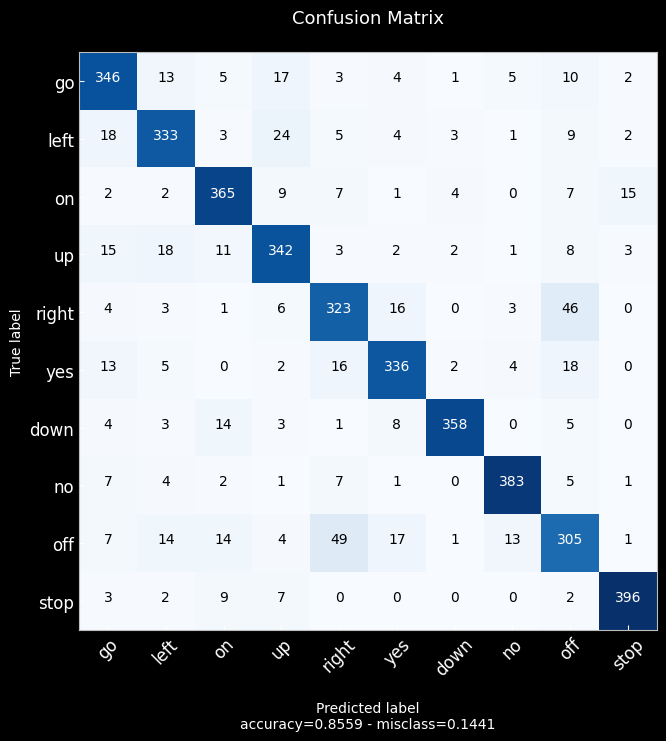

In [ ]:
plot_confusion_matrix(matrix, labels_10_classes)

### Test Error

In [ ]:
best_1_conv2d_1_dense_model.evaluate(X_test_envelope, y_test)

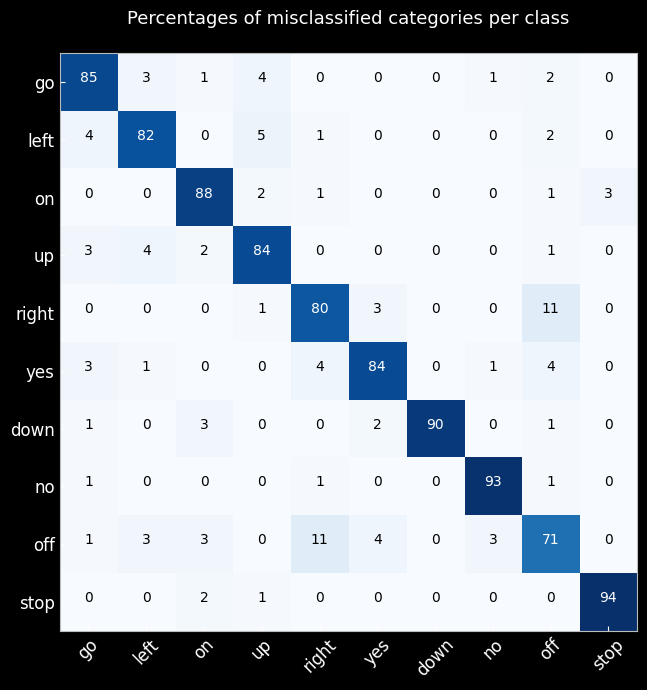

In [ ]:
percentages_misclassified_samples = np.ones_like(matrix)
sums = np.sum(matrix, axis = 1)

for i in range(matrix.shape[0]):
    percentages_misclassified_samples[i] = matrix[i] / sums[i] * 100

# percentages_misclassified_samples
plot_confusion_matrix(percentages_misclassified_samples, labels_10_classes, title = "Percentages of misclassified samples per class", display_metrics = False)

### Prediction Time of $\mathcal{M}_3$

In [ ]:
starts = np.empty((len(X_test_envelope), ))
ends = np.empty((len(X_test_envelope), ))

for i in range(len(X_test_envelope)):

    a = np.array([X_test_envelope[i]])

    starts[i] = time.time()
    a = np.argmax(best_1_conv2d_1_dense_model.predict(a),1)
    ends[i] = time.time()

average = sum(ends-starts)/len(X_test_envelope)

print("Average single prediction time (ms):", 1000*average)

Average single prediction time (ms): 38.953132704302675


## 4. Post-hoc analyses on:

    - Misclassified Data Analysis (sanity check)
    - Weights and Activation's Distribution  
    - Saliency Maps (on misclassified data)
    - Conclusions and further way of improvement 
    

___
## 1. Hyper-parameter Space $\mathcal{H}$ Search with a fixed architecture  (m`Conv2D`+ n `Dense`)
___

In [ ]:
def flexible_cnn_architecture(hp, name = None, input_shape = (13,99,1), num_classes=10):
    
    
    # ----------------------------------------------------------------
    # Declare the interval or set of hyperparameters for each quantity  
    # ----------------------------------------------------------------

    # Cnn - Hyperparameters

    # num_filters = hp.Int(name="filter_number", min_value=16, max_value=64, step=16) # (square) number of kernels 
    kernel_dims = hp.Int(name="kernel_dims", min_value=3, max_value=10, step=1) # (square) kernel dimension 
    paddings = hp.Choice(name="padding_type", values = ["same", "valid"]) # Padding type
    strides = hp.Int(name="stride", min_value = 1, max_value = 4, step = 1) # Stride quantity
    conv_layers = hp.Int(name="conv_layers", min_value = 1, max_value = 4, step = 1)

    # Dense - Hyperparameters

    dense_layers = hp.Int(name="dense_layers", min_value = 1, max_value = 4, step = 1)
    units = hp.Int(name="units", min_value=16, max_value=64, step=16) # dense units' interval 

    # Common - Hyperparameters

    # activations  =   hp.Choice(name = "activations", values = ["relu"]) # set of activations
    # initializers =   hp.Choice(name = "initialization_scheme", values=[tf.keras.initializers.HeNormal(),tf.keras.initializers.GlorotUniform(),tf.keras.initializers.RandomNormal(mean=0., stddev=1.)])
    optimizers   =   hp.Choice(name = "optimizer", values=["SGD", "adam"]) # set of optimizers  
    dropout_probabilities =  hp.Float(name="dropout_probabilities", min_value = 0, max_value = 0.5, step = 0.1)

    # ---------------------------------------------
    # Declare Model's Architecture - Functional API 
    # ---------------------------------------------    

    inputs = keras.Input(shape = input_shape)
    
    x = inputs

    for i in range(conv_layers):
            x = layers.Conv2D(
                hp.Int(f"filters_{i}", 32, 128, step=16),
                kernel_size = kernel_dims,
                strides = strides,
                padding = "same",
                activation = "relu",
                kernel_initializer = tf.keras.initializers.HeNormal(),
            )(x)
            x = layers.Dropout(dropout_probabilities)(x)
    
    
    for i in range(dense_layers):
        x = layers.Dense(units, activation = "relu", kernel_initializer = tf.keras.initializers.HeNormal())(x)
        x = layers.Dropout(dropout_probabilities)(x)

    x = layers.Flatten()(x)

    outputs = layers.Dense(num_classes, activation = "softmax")(x)
    
    # ----------------
    # Define the Model 
    # ----------------

    model = keras.Model(inputs = inputs, outputs = outputs, name = name)

    model.compile(
        optimizer=optimizers,
        loss="sparse_categorical_crossentropy",
        metrics=["accuracy"])

    return model

In [ ]:
tuner = kt.Hyperband(
    hypermodel=flexible_cnn_architecture,
    objective="val_accuracy",
    executions_per_trial=3,
    directory="./results_flexible_cnn_architecture",
    overwrite=False,
)

INFO:tensorflow:Reloading Oracle from existing project ./results_flexible_cnn_architecture/untitled_project/oracle.json
INFO:tensorflow:Reloading Tuner from ./results_flexible_cnn_architecture/untitled_project/tuner0.json


### Summarizing the Hyperparameter Space's Content

In [ ]:
tuner.search_space_summary()

Search space summary
Default search space size: 12
kernel_dims (Int)
{'default': None, 'conditions': [], 'min_value': 3, 'max_value': 10, 'step': 1, 'sampling': None}
padding_type (Choice)
{'default': 'same', 'conditions': [], 'values': ['same', 'valid'], 'ordered': False}
stride (Int)
{'default': None, 'conditions': [], 'min_value': 1, 'max_value': 4, 'step': 1, 'sampling': None}
conv_layers (Int)
{'default': None, 'conditions': [], 'min_value': 1, 'max_value': 4, 'step': 1, 'sampling': None}
dense_layers (Int)
{'default': None, 'conditions': [], 'min_value': 1, 'max_value': 4, 'step': 1, 'sampling': None}
units (Int)
{'default': None, 'conditions': [], 'min_value': 16, 'max_value': 64, 'step': 16, 'sampling': None}
optimizer (Choice)
{'default': 'SGD', 'conditions': [], 'values': ['SGD', 'adam'], 'ordered': False}
dropout_probabilities (Float)
{'default': 0.0, 'conditions': [], 'min_value': 0.0, 'max_value': 0.5, 'step': 0.1, 'sampling': None}
filters_0 (Int)
{'default': None, 'condi

### Keras' Learning Features 

In [ ]:
callbacks = [
    keras.callbacks.EarlyStopping(monitor="val_loss", patience=5),
    keras.callbacks.TensorBoard("./tb_logs_flexible_cnn_architecture")
]

### Starting the Search with Hyperband

In [ ]:
tuner.search(
    X_train_envelope, y_train,
    batch_size=128,
    epochs=100,
    validation_data=(X_valid_envelope, y_valid),
    callbacks=callbacks,
    verbose=2,
)

INFO:tensorflow:Oracle triggered exit


### Tensorboard Visualization of all trials for `mConv2D`+`nDense`

In [ ]:
!kill 4913

/bin/bash: line 0: kill: (4913) - No such process


In [ ]:
%load_ext tensorboard
%tensorboard --logdir ./tb_logs_flexible_cnn_architecture

Reusing TensorBoard on port 6006 (pid 4913), started 10 days, 4:14:47 ago. (Use '!kill 4913' to kill it.)

<IPython.core.display.Javascript object>

___
## 2. Selection of the 5 best performing models $\mathcal{M}_{0,1,2,3,4,\dots,9}$ on the validation set $\mathcal{V}$. Retrain them in both training $\mathcal{T}$ and validation $\mathcal{V}$ sets and obtain the test set $\mathcal{S}$ performance 
___

In [ ]:
top_n = 10
best_hps = tuner.get_best_hyperparameters(top_n)

In [ ]:
def plot_history(history, model = None, save_path = None, validation = True, data_type = None):
    
    """

    Plots accuracy/loss for training/validation set as a function of the epochs.

    Parameters:
      history: Training history of model.
      model: model onject.
      filename: Name of the file.

    """
    
    fig, axs = plt.subplots(2)

    # Create accuracy subplot
    axs[0].plot(history.history["accuracy"], label="accuracy")
    if validation: 
        axs[0].plot(history.history['val_accuracy'], label="val_accuracy")
    axs[0].set_ylabel("Accuracy")
    axs[0].legend(loc="lower right")
    axs[0].set_title("Accuracy evaluation of {} - {} data".format(model._name if model else "Unspecified", data_type if model else "Unspecified"))

    # Create loss subplot
    axs[1].plot(history.history["loss"], label="loss")
    if validation:
        axs[1].plot(history.history['val_loss'], label="val_loss")
    axs[1].set_xlabel("Epoch")
    axs[1].set_ylabel("Loss")
    axs[1].legend(loc="upper right")
    axs[1].set_title("Loss evaluation {} - {} data".format(model._name if model else "Unspecified", data_type if model else "Unspecified"))

    if save_path: 
        plt.savefig(save_path)

    plt.show()

In [ ]:
def get_best_epoch(hp):
    
    """
    
    """
    
    model = flexible_cnn_architecture(hp)

    model.summary()

    callbacks=[
        keras.callbacks.EarlyStopping(
            monitor="val_loss", mode="min", patience=10)
    ]

    history = model.fit(
        X_train_envelope, y_train,
        validation_data=(X_valid_envelope, y_valid),
        epochs=100,
        batch_size=128,
        callbacks=callbacks)
    
    plot_history(history, model, data_type = input("Insert the type of data on which the network was trained:  "))

    val_loss_per_epoch = history.history["val_loss"]

    best_epoch = val_loss_per_epoch.index(min(val_loss_per_epoch)) + 1

    print(f"Best epoch: {best_epoch}")
    
    return best_epoch, model

In [ ]:
def get_best_trained_model(hp):

    best_epoch, model = get_best_epoch(hp)

    history = model.fit(
         np.concatenate((X_train_envelope, X_valid_envelope), axis=0),  np.concatenate((y_train, y_valid), axis=0),
         batch_size=128,
         epochs=int(best_epoch * 1.12))
    
    return model, history

Model: "model_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_4 (InputLayer)        [(None, 13, 99, 1)]       0         
                                                                 
 conv2d_7 (Conv2D)           (None, 7, 50, 48)         3120      
                                                                 
 dropout_10 (Dropout)        (None, 7, 50, 48)         0         
                                                                 
 conv2d_8 (Conv2D)           (None, 4, 25, 112)        344176    
                                                                 
 dropout_11 (Dropout)        (None, 4, 25, 112)        0         
                                                                 
 conv2d_9 (Conv2D)           (None, 2, 13, 48)         344112    
                                                                 
 dropout_12 (Dropout)        (None, 2, 13, 48)         0   

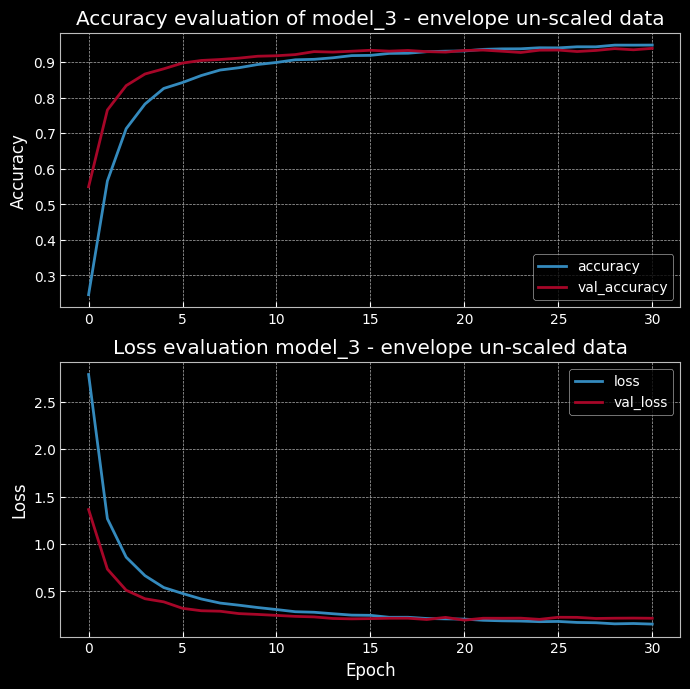

Best epoch: 21
Epoch 1/23
270/270 [==============================] - 6s 21ms/step - loss: 0.1776 - accuracy: 0.9445
Epoch 2/23
270/270 [==============================] - 5s 20ms/step - loss: 0.1638 - accuracy: 0.9470
Epoch 3/23
270/270 [==============================] - 5s 20ms/step - loss: 0.1609 - accuracy: 0.9487
Epoch 4/23
270/270 [==============================] - 5s 20ms/step - loss: 0.1551 - accuracy: 0.9501
Epoch 5/23
270/270 [==============================] - 5s 20ms/step - loss: 0.1476 - accuracy: 0.9510
Epoch 6/23
270/270 [==============================] - 5s 20ms/step - loss: 0.1456 - accuracy: 0.9520
Epoch 7/23
270/270 [==============================] - 6s 20ms/step - loss: 0.1418 - accuracy: 0.9534
Epoch 8/23
270/270 [==============================] - 5s 20ms/step - loss: 0.1356 - accuracy: 0.9557
Epoch 9/23
270/270 [==============================] - 5s 20ms/step - loss: 0.1372 - accuracy: 0.9554
Epoch 10/23
270/270 [==============================] - 5s 20ms/step - loss: 

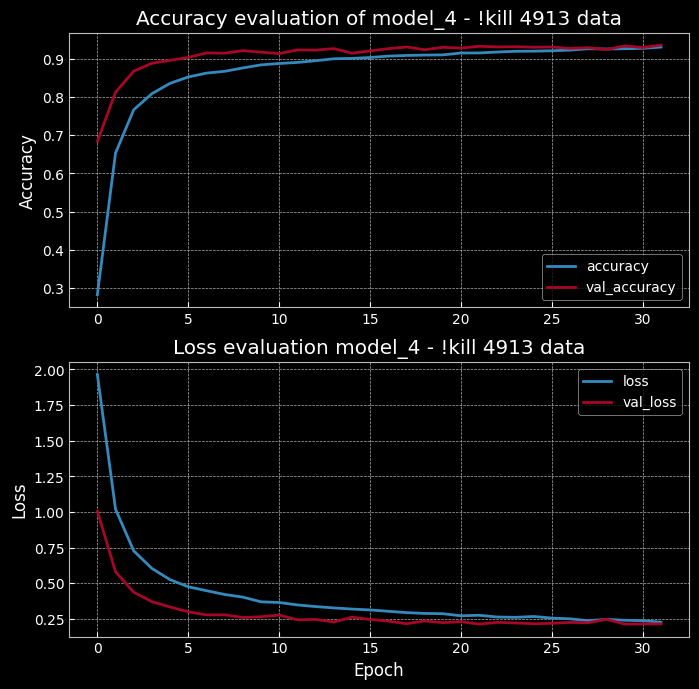

Best epoch: 22
Epoch 1/24
270/270 [==============================] - 6s 21ms/step - loss: 0.2448 - accuracy: 0.9265
Epoch 2/24
270/270 [==============================] - 5s 20ms/step - loss: 0.2465 - accuracy: 0.9254
Epoch 3/24
270/270 [==============================] - 5s 20ms/step - loss: 0.2318 - accuracy: 0.9271
Epoch 4/24
270/270 [==============================] - 5s 20ms/step - loss: 0.2303 - accuracy: 0.9308
Epoch 5/24
270/270 [==============================] - 5s 20ms/step - loss: 0.2310 - accuracy: 0.9294
Epoch 6/24
270/270 [==============================] - 5s 20ms/step - loss: 0.2208 - accuracy: 0.9319
Epoch 7/24
270/270 [==============================] - 5s 20ms/step - loss: 0.2206 - accuracy: 0.9329
Epoch 8/24
270/270 [==============================] - 5s 20ms/step - loss: 0.2208 - accuracy: 0.9327
Epoch 9/24
270/270 [==============================] - 5s 20ms/step - loss: 0.2108 - accuracy: 0.9341
Epoch 10/24
270/270 [==============================] - 5s 20ms/step - loss: 

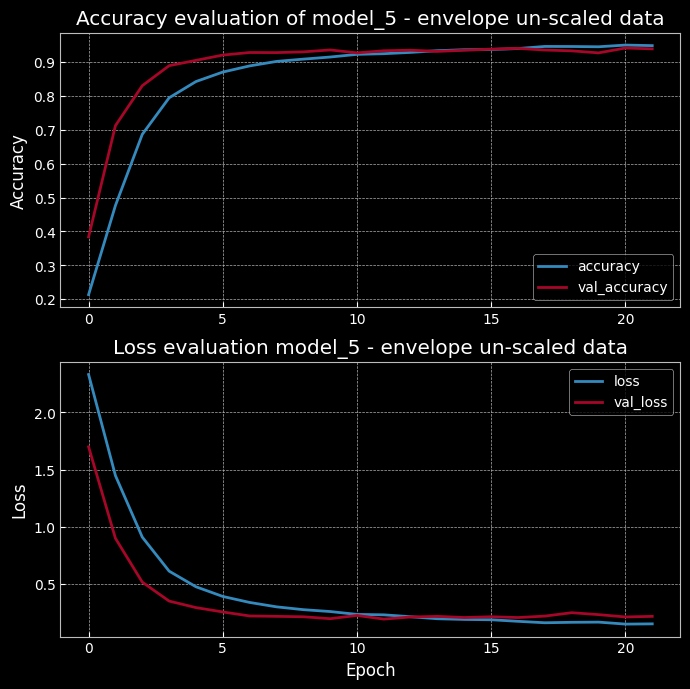

Best epoch: 12
Epoch 1/13
270/270 [==============================] - 6s 21ms/step - loss: 0.1657 - accuracy: 0.9471
Epoch 2/13
270/270 [==============================] - 6s 20ms/step - loss: 0.1598 - accuracy: 0.9489
Epoch 3/13
270/270 [==============================] - 6s 21ms/step - loss: 0.1432 - accuracy: 0.9537
Epoch 4/13
270/270 [==============================] - 6s 20ms/step - loss: 0.1527 - accuracy: 0.9508
Epoch 5/13
270/270 [==============================] - 6s 21ms/step - loss: 0.1419 - accuracy: 0.9545
Epoch 6/13
270/270 [==============================] - 6s 21ms/step - loss: 0.1283 - accuracy: 0.9582
Epoch 7/13
270/270 [==============================] - 6s 21ms/step - loss: 0.1353 - accuracy: 0.9574
Epoch 8/13
270/270 [==============================] - 6s 21ms/step - loss: 0.1272 - accuracy: 0.9591
Epoch 9/13
270/270 [==============================] - 6s 21ms/step - loss: 0.1196 - accuracy: 0.9614
Epoch 10/13
270/270 [==============================] - 6s 21ms/step - loss: 

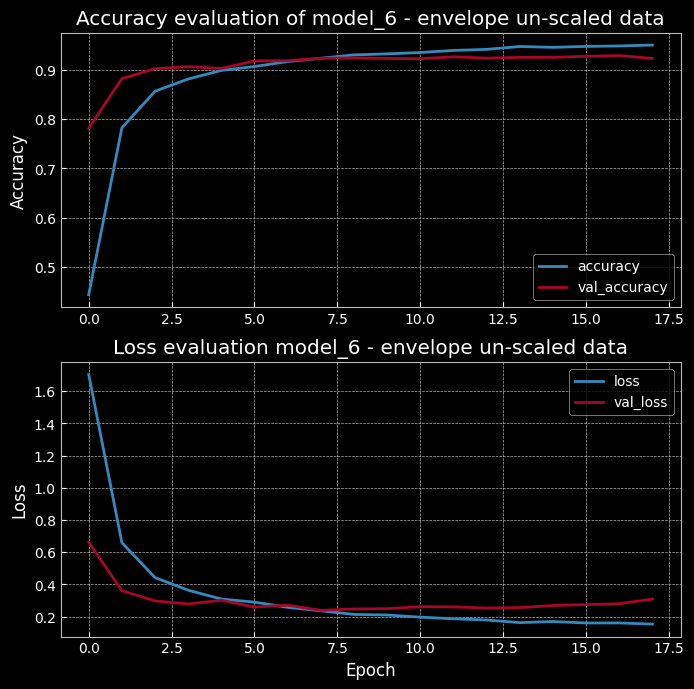

Best epoch: 8
Epoch 1/8
270/270 [==============================] - 13s 47ms/step - loss: 0.1697 - accuracy: 0.9476
Epoch 2/8
270/270 [==============================] - 13s 47ms/step - loss: 0.1587 - accuracy: 0.9499
Epoch 3/8
270/270 [==============================] - 13s 47ms/step - loss: 0.1416 - accuracy: 0.9544
Epoch 4/8
270/270 [==============================] - 13s 47ms/step - loss: 0.1449 - accuracy: 0.9545
Epoch 5/8
270/270 [==============================] - 13s 47ms/step - loss: 0.1326 - accuracy: 0.9557
Epoch 6/8
270/270 [==============================] - 13s 47ms/step - loss: 0.1257 - accuracy: 0.9605
Epoch 7/8
270/270 [==============================] - 13s 47ms/step - loss: 0.1226 - accuracy: 0.9611
Epoch 8/8
270/270 [==============================] - 13s 47ms/step - loss: 0.1388 - accuracy: 0.9563


128/128 [==============================] - 1s 8ms/step - loss: 0.2754 - accuracy: 0.9234
test_loss:  0.2754009962081909 
test_accuracy:  0.923416793346405
Model: "model_7"
____

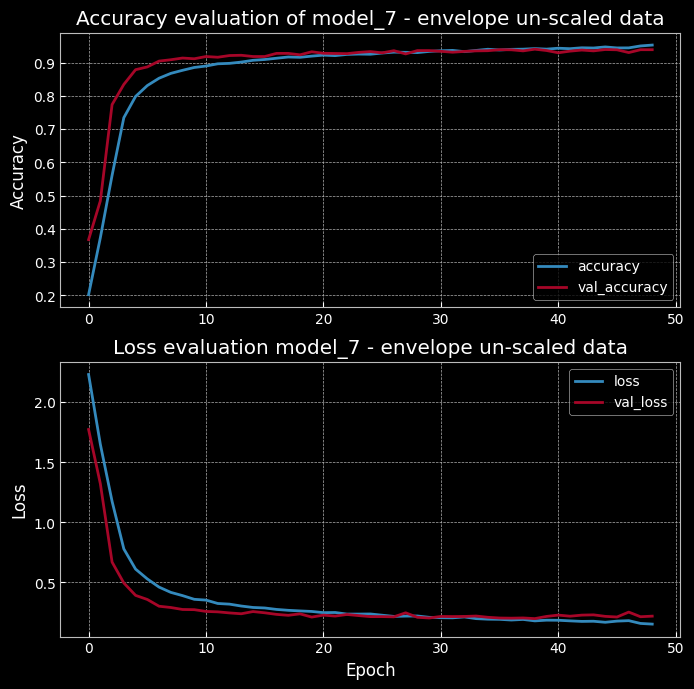

Best epoch: 39
Epoch 1/43
270/270 [==============================] - 8s 29ms/step - loss: 0.1812 - accuracy: 0.9463
Epoch 2/43
270/270 [==============================] - 8s 28ms/step - loss: 0.1901 - accuracy: 0.9427
Epoch 3/43
270/270 [==============================] - 8s 28ms/step - loss: 0.1735 - accuracy: 0.9488
Epoch 4/43
270/270 [==============================] - 8s 28ms/step - loss: 0.1736 - accuracy: 0.9473
Epoch 5/43
270/270 [==============================] - 8s 28ms/step - loss: 0.1706 - accuracy: 0.9483
Epoch 6/43
270/270 [==============================] - 8s 28ms/step - loss: 0.1606 - accuracy: 0.9503
Epoch 7/43
270/270 [==============================] - 8s 28ms/step - loss: 0.1580 - accuracy: 0.9518
Epoch 8/43
270/270 [==============================] - 8s 28ms/step - loss: 0.1613 - accuracy: 0.9503
Epoch 9/43
270/270 [==============================] - 8s 28ms/step - loss: 0.1637 - accuracy: 0.9499
Epoch 10/43
270/270 [==============================] - 8s 28ms/step - loss: 

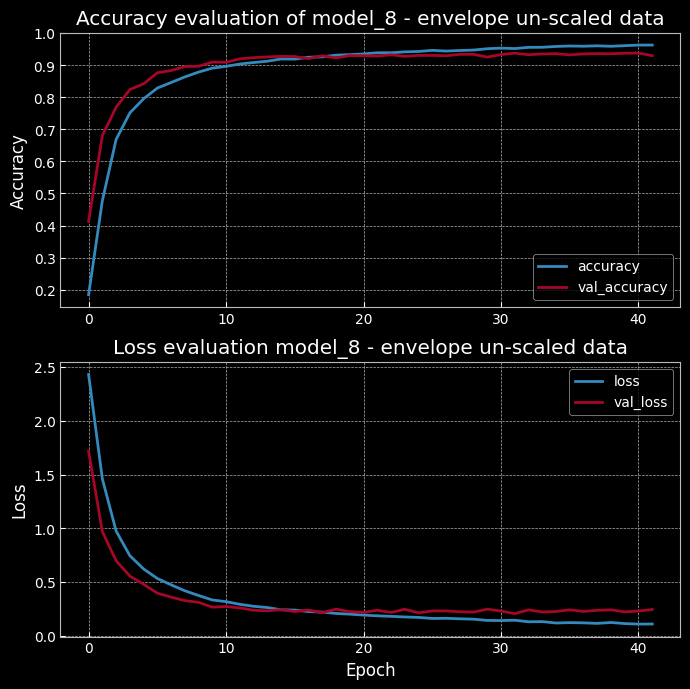

Best epoch: 32
Epoch 1/35
270/270 [==============================] - 4s 14ms/step - loss: 0.1416 - accuracy: 0.9563
Epoch 2/35
270/270 [==============================] - 4s 13ms/step - loss: 0.1218 - accuracy: 0.9618
Epoch 3/35
270/270 [==============================] - 4s 14ms/step - loss: 0.1183 - accuracy: 0.9611
Epoch 4/35
270/270 [==============================] - 4s 14ms/step - loss: 0.1180 - accuracy: 0.9617
Epoch 5/35
270/270 [==============================] - 4s 13ms/step - loss: 0.1087 - accuracy: 0.9643
Epoch 6/35
270/270 [==============================] - 4s 13ms/step - loss: 0.1038 - accuracy: 0.9656
Epoch 7/35
270/270 [==============================] - 4s 14ms/step - loss: 0.1045 - accuracy: 0.9654
Epoch 8/35
270/270 [==============================] - 4s 14ms/step - loss: 0.1017 - accuracy: 0.9673
Epoch 9/35
270/270 [==============================] - 4s 14ms/step - loss: 0.0962 - accuracy: 0.9680
Epoch 10/35
270/270 [==============================] - 4s 14ms/step - loss: 

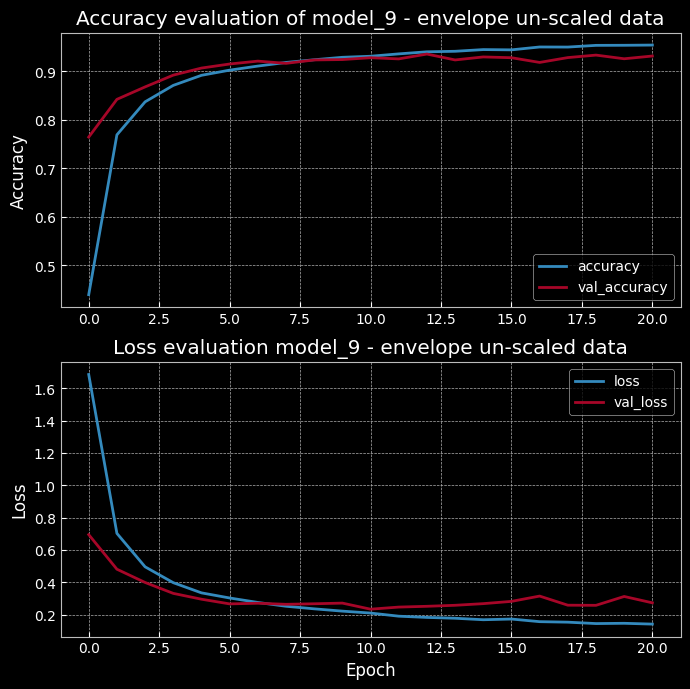

Best epoch: 11
Epoch 1/12
270/270 [==============================] - 13s 46ms/step - loss: 0.1753 - accuracy: 0.9467
Epoch 2/12
270/270 [==============================] - 13s 47ms/step - loss: 0.1468 - accuracy: 0.9537
Epoch 3/12
270/270 [==============================] - 13s 48ms/step - loss: 0.1360 - accuracy: 0.9562
Epoch 4/12
270/270 [==============================] - 13s 48ms/step - loss: 0.1398 - accuracy: 0.9558
Epoch 5/12
270/270 [==============================] - 13s 47ms/step - loss: 0.1302 - accuracy: 0.9583
Epoch 6/12
270/270 [==============================] - 13s 47ms/step - loss: 0.1308 - accuracy: 0.9582
Epoch 7/12
270/270 [==============================] - 13s 47ms/step - loss: 0.1205 - accuracy: 0.9616
Epoch 8/12
270/270 [==============================] - 13s 47ms/step - loss: 0.1172 - accuracy: 0.9622
Epoch 9/12
270/270 [==============================] - 13s 47ms/step - loss: 0.1186 - accuracy: 0.9628
Epoch 10/12
270/270 [==============================] - 13s 47ms/ste

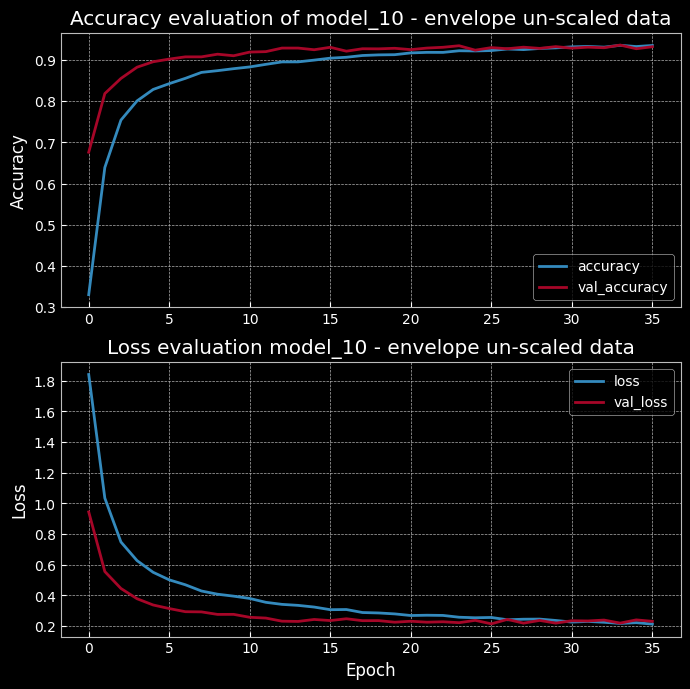

Best epoch: 26
Epoch 1/29
270/270 [==============================] - 6s 21ms/step - loss: 0.2307 - accuracy: 0.9307
Epoch 2/29
270/270 [==============================] - 6s 21ms/step - loss: 0.2279 - accuracy: 0.9324
Epoch 3/29
270/270 [==============================] - 6s 21ms/step - loss: 0.2156 - accuracy: 0.9355
Epoch 4/29
270/270 [==============================] - 6s 21ms/step - loss: 0.2144 - accuracy: 0.9368
Epoch 5/29
270/270 [==============================] - 6s 21ms/step - loss: 0.2150 - accuracy: 0.9365
Epoch 6/29
270/270 [==============================] - 6s 21ms/step - loss: 0.2086 - accuracy: 0.9378
Epoch 7/29
270/270 [==============================] - 6s 21ms/step - loss: 0.2034 - accuracy: 0.9389
Epoch 8/29
270/270 [==============================] - 6s 21ms/step - loss: 0.2123 - accuracy: 0.9364
Epoch 9/29
270/270 [==============================] - 6s 21ms/step - loss: 0.2080 - accuracy: 0.9370
Epoch 10/29
270/270 [==============================] - 6s 21ms/step - loss: 

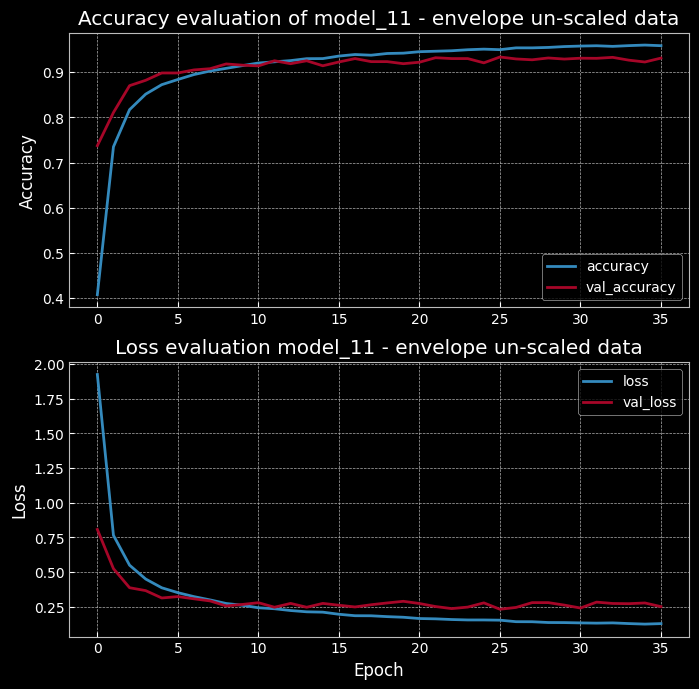

Best epoch: 26
Epoch 1/29
270/270 [==============================] - 12s 45ms/step - loss: 0.1535 - accuracy: 0.9533
Epoch 2/29
270/270 [==============================] - 12s 45ms/step - loss: 0.1413 - accuracy: 0.9558
Epoch 3/29
270/270 [==============================] - 12s 46ms/step - loss: 0.1303 - accuracy: 0.9584
Epoch 4/29
270/270 [==============================] - 12s 46ms/step - loss: 0.1245 - accuracy: 0.9608
Epoch 5/29
270/270 [==============================] - 13s 47ms/step - loss: 0.1244 - accuracy: 0.9612
Epoch 6/29
270/270 [==============================] - 13s 47ms/step - loss: 0.1272 - accuracy: 0.9601
Epoch 7/29
270/270 [==============================] - 13s 48ms/step - loss: 0.1191 - accuracy: 0.9629
Epoch 8/29
270/270 [==============================] - 13s 48ms/step - loss: 0.1143 - accuracy: 0.9626
Epoch 9/29
270/270 [==============================] - 13s 47ms/step - loss: 0.1137 - accuracy: 0.9630
Epoch 10/29
270/270 [==============================] - 13s 48ms/ste

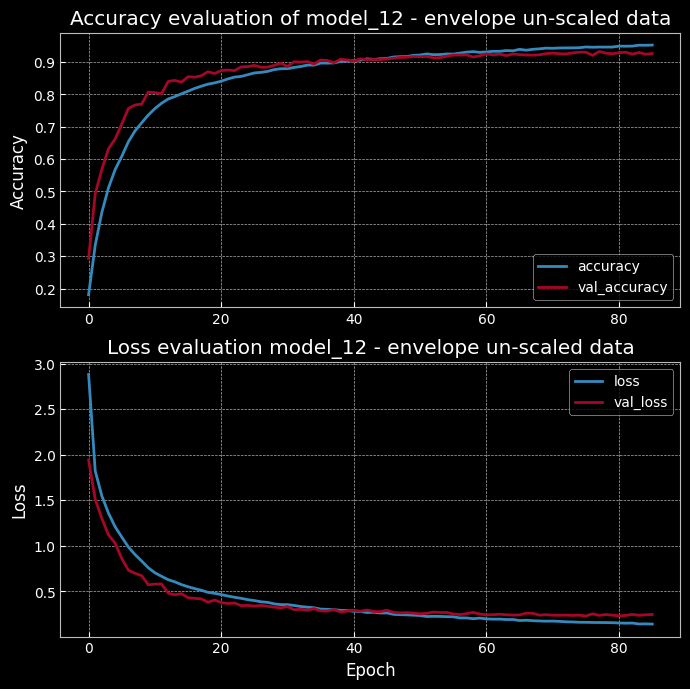

Best epoch: 76
Epoch 1/85
270/270 [==============================] - 4s 16ms/step - loss: 0.1628 - accuracy: 0.9469
Epoch 2/85
270/270 [==============================] - 4s 15ms/step - loss: 0.1575 - accuracy: 0.9463
Epoch 3/85
270/270 [==============================] - 4s 15ms/step - loss: 0.1567 - accuracy: 0.9478
Epoch 4/85
270/270 [==============================] - 4s 15ms/step - loss: 0.1508 - accuracy: 0.9493
Epoch 5/85
270/270 [==============================] - 4s 15ms/step - loss: 0.1509 - accuracy: 0.9494
Epoch 6/85
270/270 [==============================] - 4s 15ms/step - loss: 0.1439 - accuracy: 0.9519
Epoch 7/85
270/270 [==============================] - 4s 15ms/step - loss: 0.1428 - accuracy: 0.9510
Epoch 8/85
270/270 [==============================] - 4s 15ms/step - loss: 0.1407 - accuracy: 0.9513
Epoch 9/85
270/270 [==============================] - 4s 15ms/step - loss: 0.1393 - accuracy: 0.9540
Epoch 10/85
270/270 [==============================] - 4s 15ms/step - loss: 

In [ ]:
best_results = []

for i, hp in enumerate(best_hps):

    model, history = get_best_trained_model(hp)

    print("====================================================================================\n")
    print("====================================================================================\n")

    test_loss, test_accuracy = model.evaluate(X_test_envelope, y_test)

    print("test_loss: ", test_loss, "\ntest_accuracy: ", test_accuracy)

    model.save('best_flexible_cnn_architecture_model_no_{}.h5'.format(i))

    best_results.append((test_loss, test_accuracy))


In [ ]:
for i,result in enumerate(best_results): 
    print("The best result no.{} has {:.2f} as test loss and {:.2f} as test accuracy".format(i, result[0], result[1]))

The best result no.0 has 0.24 as test loss and 0.94 as test accuracy
The best result no.1 has 0.22 as test loss and 0.93 as test accuracy
The best result no.2 has 0.21 as test loss and 0.95 as test accuracy
The best result no.3 has 0.28 as test loss and 0.92 as test accuracy
The best result no.4 has 0.24 as test loss and 0.94 as test accuracy
The best result no.5 has 0.24 as test loss and 0.94 as test accuracy
The best result no.6 has 0.36 as test loss and 0.93 as test accuracy
The best result no.7 has 0.28 as test loss and 0.93 as test accuracy
The best result no.8 has 0.28 as test loss and 0.94 as test accuracy
The best result no.9 has 0.23 as test loss and 0.94 as test accuracy


In [ ]:
!pwd

/content


### Saving Models

In [ ]:
# for i, model in enumerate(best_models): 
#     model.save('best_flexible_cnn_architecture_model_no_{}.h5'.format(i))

---
## 3. Select the best test performing model $\mathcal{M}^* = \underset{i \in {1,2,3,4,5}}{\operatorname{max}} \underset{\mathcal{S}}{\operatorname{accuracy}}(\mathcal{M}_i$) and computing its confusion matrix $\mathbb{M}$
---

From $\mathcal{H} \rightarrow $  $\mathcal{M}_3$ has gained a $86\%$ accuracy on the test set.  

In [ ]:
!pwd
!dir

/content/drive/MyDrive/University/HDA
data	   LICENSE    models	 README.md	   results  useful\ books
documents  model.png  notebooks  requirements.txt  src	    utilities


### Loading Best Model

In [ ]:
best_models = []
for i in range(10):
    model =  models.load_model(FRA_PATH + f"/models/m_conv2d_n_dense_models/best_flexible_cnn_architecture_model_no_{i}.h5")
    best_models.append((model.evaluate(X_test_envelope, y_test), model.count_params()))
    print(f"Number of paramters in the model: {model.count_par dataset

128/128 [==============================] - 1s 5ms/step - loss: 0.2374 - accuracy: 0.9399
Number of paramters in the model: 701306
128/128 [==============================] - 1s 6ms/step - loss: 0.2201 - accuracy: 0.9347
Number of paramters in the model: 1607290
128/128 [==============================] - 1s 4ms/step - loss: 0.2060 - accuracy: 0.9460
Number of paramters in the model: 701306
128/128 [==============================] - 1s 8ms/step - loss: 0.2754 - accuracy: 0.9234
Number of paramters in the model: 2800970
128/128 [==============================] - 1s 5ms/step - loss: 0.2373 - accuracy: 0.9433
Number of paramters in the model: 1077418
128/128 [==============================] - 1s 4ms/step - loss: 0.2364 - accuracy: 0.9399
Number of paramters in the model: 195882
128/128 [==============================] - 1s 8ms/step - loss: 0.3559 - accuracy: 0.9256
Number of paramters in the model: 2800970
128/128 [==============================] - 1s 5ms/step - loss: 0.2792 - accuracy: 0.92

In [ ]:
best_m_conv2d_n_dense_model = models.load_model(FRA_PATH+"/models/m_conv2d_n_dense_models/best_flexible_cnn_architecture_model_no_5.h5") if colab else models.load_model("./best_flexible_cnn_architecture_model_no_5.h5")

In [ ]:
best_m_conv2d_n_dense_model.summary()

Model: "model_8"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_9 (InputLayer)        [(None, 13, 99, 1)]       0         
                                                                 
 conv2d_25 (Conv2D)          (None, 7, 50, 48)         2400      
                                                                 
 dropout_34 (Dropout)        (None, 7, 50, 48)         0         
                                                                 
 conv2d_26 (Conv2D)          (None, 4, 25, 48)         112944    
                                                                 
 dropout_35 (Dropout)        (None, 4, 25, 48)         0         
                                                                 
 conv2d_27 (Conv2D)          (None, 2, 13, 32)         75296     
                                                                 
 dropout_36 (Dropout)        (None, 2, 13, 32)         0   

In [ ]:
best_m_conv2d_n_dense_model.get_config()

{'input_layers': [['input_9', 0, 0]],
 'layers': [{'class_name': 'InputLayer',
   'config': {'batch_input_shape': (None, 13, 99, 1),
    'dtype': 'float32',
    'name': 'input_9',
    'ragged': False,
    'sparse': False},
   'inbound_nodes': [],
   'name': 'input_9'},
  {'class_name': 'Conv2D',
   'config': {'activation': 'relu',
    'activity_regularizer': None,
    'bias_constraint': None,
    'bias_initializer': {'class_name': 'Zeros', 'config': {}},
    'bias_regularizer': None,
    'data_format': 'channels_last',
    'dilation_rate': (1, 1),
    'dtype': 'float32',
    'filters': 48,
    'groups': 1,
    'kernel_constraint': None,
    'kernel_initializer': {'class_name': 'HeNormal', 'config': {'seed': None}},
    'kernel_regularizer': None,
    'kernel_size': (7, 7),
    'name': 'conv2d_25',
    'padding': 'same',
    'strides': (2, 2),
    'trainable': True,
    'use_bias': True},
   'inbound_nodes': [[['input_9', 0, 0, {}]]],
   'name': 'conv2d_25'},
  {'class_name': 'Dropout',

### Confusion Matrix $\mathbb{M}_{\mathcal{M}_5}$

In [ ]:
labels_10_classes = {'go': 0, 'left': 1, 'on': 2, 'up': 3, 'right': 4, 'yes': 5, 'down': 6, 'no': 7, 'off': 8, 'stop': 9}

In [ ]:
y_pred = best_m_conv2d_n_dense_model.predict(X_test_envelope)
y_pred.shape

(4074, 10)

In [ ]:
y_pred = best_m_conv2d_n_dense_model.predict(X_test_envelope)
matrix = confusion_matrix(y_test, y_pred.argmax(axis=1))

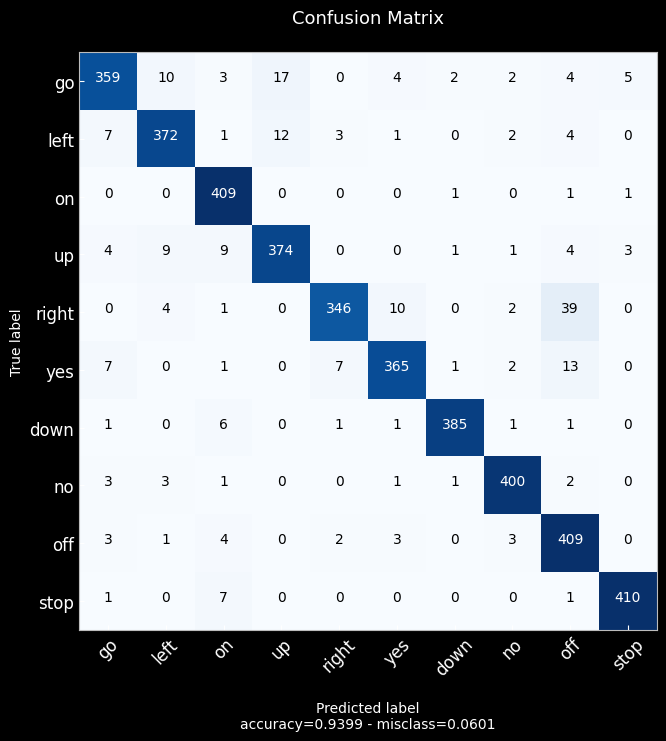

In [ ]:
plot_confusion_matrix(matrix, labels_10_classes)

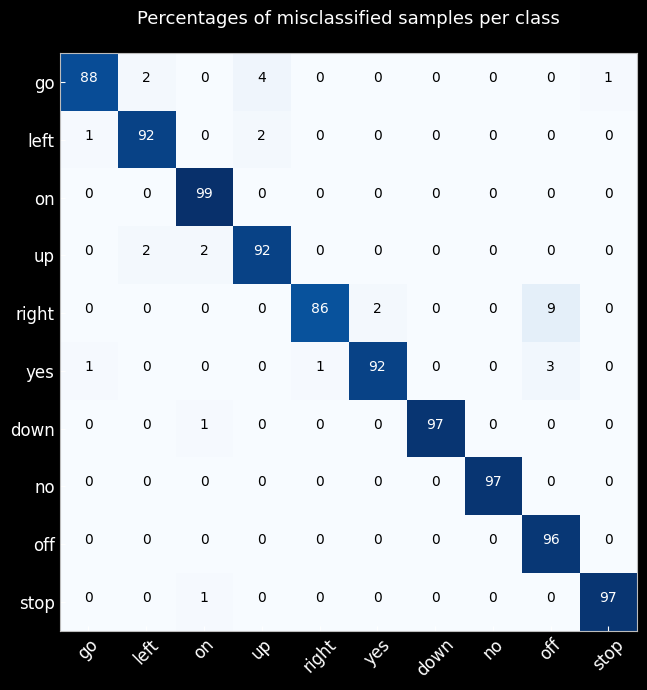

In [ ]:
percentages_misclassified_samples = np.ones_like(matrix)
sums = np.sum(matrix, axis = 1)

for i in range(matrix.shape[0]):
    percentages_misclassified_samples[i] = matrix[i] / sums[i] * 100

# percentages_misclassified_samples
plot_confusion_matrix(percentages_misclassified_samples, labels_10_classes, title = "Percentages of misclassified samples per class", display_metrics = False)

### Prediction Time of $\mathcal{M}_5$

In [ ]:
starts = np.empty((len(X_test_envelope), ))
ends = np.empty((len(X_test_envelope), ))

for i in range(len(X_test_envelope)):

    a = np.array([X_test_envelope[i]])

    starts[i] = time.time()
    a = np.argmax(best_m_conv2d_n_dense_model.predict(a),1)
    ends[i] = time.time()

average = sum(ends-starts)/len(X_test_envelope)

print("Average single prediction time (ms):", 1000*average)

Average single prediction time (ms): 40.51715173613633


## 4. Post-hoc analyses on:

    - Misclassified Data Analysis (sanity check)
    - Weights and Activation's Distribution  
    - Saliency Maps (on misclassified data)
    - Conclusions and further way of improvement 
    

## Misclassified Data Analysis (sanity check)

## Visualise Intermediate Activations - Saliency Maps per Category

In [ ]:
def show_image(X, y, encoding, index, class = None):

    """
    Parameters:
    X : tensor of shape [batch, height, width]
    index : specify which image visualize
    """
    
    img = X[:,:,:,0][index]
    
    plt.imshow(img, cmap='coolwarm', aspect='auto', origin='lower', extent=[0, 1, 40, 0])
    plt.title()
    plt.show()

---
---

### [TO ADD] Batch Normalization - feature in between layers 

As mentioned, it's best to use [-1, 1] min-max scaling or zero-mean, unit-variance standardization. Scaling your data into [0, 1] will result in slow learning.

You should still standardize your inputs to a network that uses Batch Normalization. This will ensure that inputs to the first layer have zero mean and come from the same distribution, while Batch Normalization on subsequent layers will ensure that inputs to those layers have zero mean in expectation and that their distributions do not drift over time.

STRAMEGA IMPORTANTE -> VIENE AGGIUNTA LA FUNZIONE DI ATTIVAZIONE DOPO LA BATCH-NORMALIZATION 

**Types of batch normalization**




# [TO UPDATE] Things to consider in Training Neural Nets


The kind of scaling applied to data (this has effects only on the first layer of the net) 

The presence of batch-normalization 

Estimation of the variance of the model 

Estimation 

Weigths Initialization Scheme 

Property of constant variance and 0 mean of the activations across the layers

Assessing issues relating to mislead classifications 

Distribution of Activations in the net 

Gradient Clipping




Give examples of how different types of initializations can lead to different results
Examine the importance of initialization in complex neural networks
Explain the difference between train/dev/test sets
Diagnose the bias and variance issues in your model
Assess the right time and place for using regularization methods such as dropout or L2 regularization
Explain Vanishing and Exploding gradients and how to deal with them
Use gradient checking to verify the accuracy of your backpropagation implementation
Apply zeros initialization, random initialization, and He initialization
Apply regularization to a deep learning model

# Code to test functionalities


In [ ]:
toy_example = np.array([[[1,2,3],
                         [4,5,6],
                         [7,8,9]],
                        [[10,11,12],
                         [13,14,15],
                         [16,17,18]]])

In [ ]:
toy_example.shape

(2, 3, 3)

In [ ]:
np.max(toy_example) # every axis 

18

In [ ]:
np.max(toy_example, axis = 0) # point-wise maximum sample that c

array([[10, 11, 12],
       [13, 14, 15],
       [16, 17, 18]])

In [ ]:
np.max(toy_example,axis=1) # across columns

array([[ 7,  8,  9],
       [16, 17, 18]])

In [ ]:
np.max(toy_example,axis=2) # across rows

array([[ 3,  6,  9],
       [12, 15, 18]])

<AxesSubplot:ylabel='Count'>

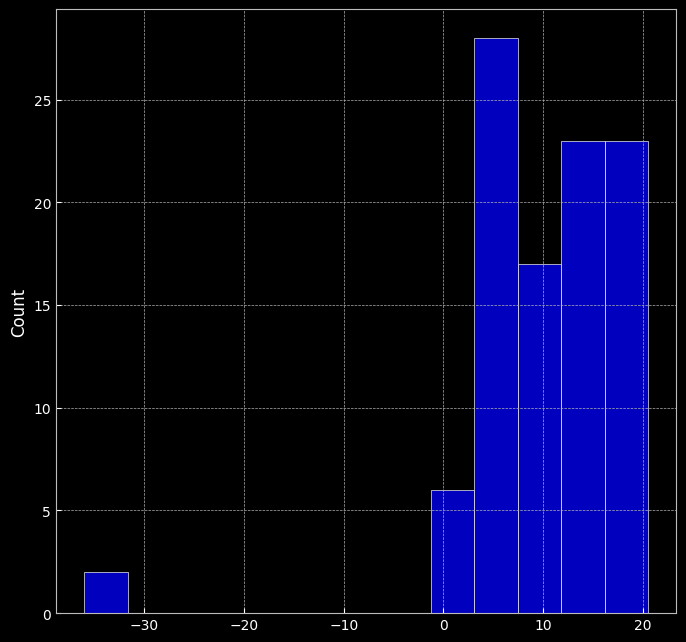

In [ ]:
sns.histplot(X_train[0][0])

In [ ]:
np.outer(np.max(np.max(X_train, axis = 2), axis = 0), np.ones((1,99))).shape

(40, 99)

(40, 99)

In [ ]:
X_train[0].shape

(40, 99)